# View images of CTIO Data in November 2016
==================================================================================================

- author : Sylvie Dagoret-Campagne
- date   : December 5th 2016

### This notebook does the calibration
-----------------------------------------
- Subtract Master-bias and correct for Master-flat
- the corrected images are saved

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os

In [2]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [3]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal

In [4]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.0.0


In [5]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [6]:
from IPython.display import Image, display

In [7]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [8]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (8, 8),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [49]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

In [50]:
outputdir="processed_fitsimages"
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [9]:
rootpath_rawimage="/Users/dagoret-campagnesylvie/MacOsX/LSST/MyWork/GitHub/CTIOData2016/November2016/HD14943"
object_name='HD14943'

In [10]:
dirlist_all=os.listdir(rootpath_rawimage) 

In [11]:
if '.DS_Store' in dirlist_all:
    dirlist_all.remove('.DS_Store')
dirlist_all=np.array(dirlist_all)

In [12]:
print dirlist_all

['2016_11_23T01_45_51' '2016_11_23T01_46_55' '2016_11_23T01_47_58'
 '2016_11_23T01_52_42' '2016_11_23T01_54_05' '2016_11_23T01_55_29'
 '2016_11_23T02_27_22' '2016_11_23T02_28_46' '2016_11_23T02_30_09'
 '2016_11_23T04_36_28' '2016_11_23T04_37_52' '2016_11_23T04_39_16'
 '2016_11_23T04_55_21' '2016_11_23T04_56_44' '2016_11_23T04_58_08'
 '2016_11_23T05_15_19' '2016_11_23T05_16_43' '2016_11_23T05_18_07'
 '2016_11_23T05_34_17' '2016_11_23T05_35_40' '2016_11_23T05_37_04'
 '2016_11_23T05_53_10' '2016_11_23T05_54_33' '2016_11_23T05_55_56'
 '2016_11_24T01_05_17' '2016_11_24T01_06_40' '2016_11_24T01_08_04'
 '2016_11_24T01_29_35' '2016_11_24T01_30_58' '2016_11_24T01_32_22'
 '2016_11_24T02_54_15' '2016_11_24T02_55_38' '2016_11_24T02_57_01'
 '2016_11_24T03_14_59' '2016_11_24T03_16_23' '2016_11_24T03_17_46'
 '2016_11_24T04_38_18' '2016_11_24T04_39_41' '2016_11_24T04_41_05'
 '2016_11_24T04_58_54' '2016_11_24T05_00_17' '2016_11_24T05_01_41'
 '2016_11_24T06_23_22' '2016_11_24T06_24_46' '2016_11_24T06_26

In [13]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [14]:
def MakeFileList():
    """
    MakeFileList : Make The List of files to open
    =============
    """
    index=0
    global indexes_files
    global filelist_fitsimages
    for dir in dirlist_all: # loop on directories, one per image       
            dir_leaf= rootpath_rawimage+'/'+dir # build the name of leaf directory
            listfiles=os.listdir(dir_leaf) 
            for filename in listfiles:
                if re.search('^calibrated.*fits.gz$',filename):  #example of filename filter
                    index=index+1
                    shortfilename=dir_leaf+'/'+filename
                    filelist_fitsimages.append(shortfilename)
                    indexes_files.append(index)
    #return index_files,filelist_fitsimages
    return

In [15]:
MakeFileList()   # Make the list

In [16]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [17]:
print indexes_files

[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117]


In [18]:
sorted_dates=np.argsort(dirlist_all)

In [19]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [20]:
print sorted_dates

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116]


In [21]:
print sorted_indexes

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116]


In [22]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_dates]

In [23]:
#sorted_numbers= [indexes_files[index] for index in sorted_indexes]
sorted_numbers=indexes_files[sorted_dates]

In [24]:
#print sorted_files

## Build full filename
----------------------------

In [25]:
sorted_filenames=[]
for file in sorted_files:
    fullfilename=os.path.join(rootpath_rawimage,file)
    sorted_filenames.append(fullfilename)

In [26]:
sorted_filenames=np.array(sorted_filenames)

## Acces to data of  images
----------------------------------

In [27]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []

In [28]:
def BuildRawImages():
    """
    BuildRawImages
    ===============
    """

    global all_dates
    global all_airmass
    global all_images
    global all_titles
    global all_header
    global all_img 
    global sorted_filenames

    for idx,file in np.ndenumerate(sorted_filenames):   
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        num=sorted_numbers[idx[0]]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        hdu_list.close()

In [29]:
BuildRawImages()

## Show images
-----------------------

In [30]:
def ShowRawImages():
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    global all_images
    global all_titles
    global object_name

    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1

    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_images[index],vmin=-10,vmax=100)
        axarr[iy,ix].set_title(all_titles[index])
    title='Raw images of '.format(object_name)
    plt.suptitle(title,size=16)        

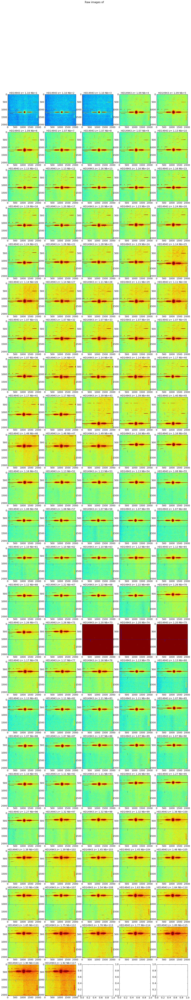

In [31]:
ShowRawImages()

In [32]:
#(y0,x0)=np.where(data2==data2.max())

## Show histograms
===========================

In [33]:
def ShowHistograms():
    """
    ShowHistograms
    ==============
    """
    global all_images
    global all_titles
    global object_name


    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMAGES):
        ix=index%5
        iy=index/5
        image_flat=all_images[index].flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=100,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo of images '.format(object_name)
    plt.suptitle(title,size=16)        

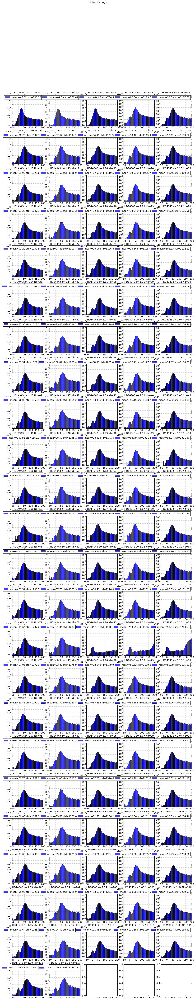

In [34]:
ShowHistograms()

## Transfer the image in CCDData
====================================

In [35]:
NBIMAGES=len(all_images)
all_ccd = []
for index in np.arange(0,NBIMAGES):
    ccd=ccdproc.CCDData(all_images[index],unit='adu')
    all_ccd.append(ccd)

## Extraction of Background
===============================

In [36]:
sigma_clip = SigmaClip(sigma=3., iters=10)

In [37]:
bkg_estimator = MedianBackground()

In [38]:
all_bkg = []  # container for all background

In [39]:
def ComputeBackground():
    """
    ComputeBackground
    ==================
    
    """
    global all_bkg
    global sigma_clip
    global bkg_estimator
    global all_ccd
    

    NBIMAGES=len(all_ccd)

    for index in np.arange(0,NBIMAGES):
        print 'compute background for image nb. ',index,' ',all_titles[index]
        bkg = Background2D(all_ccd[index], (100, 100), filter_size=(3, 3),method='median')
        #bkg = Background2D(ccd.data, (50, 50), filter_size=(3, 3),sigma_clip=sigma_clip,bkg_estimator=bkg_estimator)
        all_bkg.append(bkg)

In [40]:
ComputeBackground()

compute background for image nb.  0   HD14943 z= 1.10 Nb=1
compute background for image nb.  1   HD14943 z= 1.10 Nb=2
compute background for image nb.  2   HD14943 z= 1.10 Nb=3
compute background for image nb.  3   HD14943 z= 1.09 Nb=4
compute background for image nb.  4   HD14943 z= 1.09 Nb=5
compute background for image nb.  5   HD14943 z= 1.09 Nb=6
compute background for image nb.  6   HD14943 z= 1.07 Nb=7
compute background for image nb.  7   HD14943 z= 1.07 Nb=8
compute background for image nb.  8   HD14943 z= 1.07 Nb=9
compute background for image nb.  9   HD14943 z= 1.13 Nb=10
compute background for image nb.  10   HD14943 z= 1.13 Nb=11
compute background for image nb.  11   HD14943 z= 1.13 Nb=12
compute background for image nb.  12   HD14943 z= 1.16 Nb=13
compute background for image nb.  13   HD14943 z= 1.16 Nb=14
compute background for image nb.  14   HD14943 z= 1.16 Nb=15
compute background for image nb.  15   HD14943 z= 1.19 Nb=16
compute background for image nb.  16   HD14

## Plot Background
=========================

In [41]:
def PlotBackground():
    """
    PlotBackground
    ===============
    """
    
    global all_bkg
    global all_title
    global object_name
    
    NBBKG=len(all_bkg)
    MAXIMGROW=int(NBBKG/5)+1
      
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBBKG):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_bkg[index].background,vmin=0,vmax=60)
        axarr[iy,ix].set_title(all_titles[index])
    title='PhotUtils Background for image {}'.format(object_name)

    #f.colorbar(im, ax=axarr.ravel().tolist(),shrink=0.75)
    f.colorbar(im)
    plt.suptitle(title,size=16)    

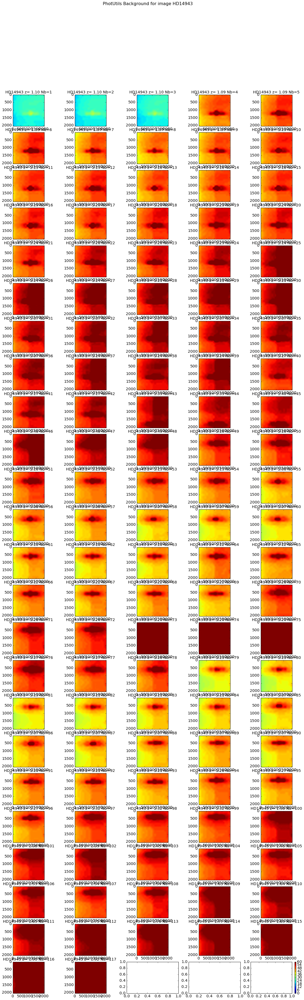

In [42]:
PlotBackground()

## Do the background subtraction again
======================================================

In [43]:
NBIMAGES=len(all_ccd)
all_ccd_bgsub = []
for index in np.arange(0,NBIMAGES):
    ccd_bgsub=all_ccd[index] - all_bkg[index].background    
    all_ccd_bgsub.append(ccd_bgsub)

In [44]:
def PlotImagesWithBGSubtraction():
    """
    """
    global all_ccd_bgsub
    global all_title
    global object_name
    
    
    NBIMG=len(all_ccd_bgsub)
    MAXIMGROW=int(NBIMG/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMG):
        ix=index%5
        iy=index/5
        im=axarr[iy,ix].imshow(all_ccd_bgsub[index],vmin=-50,vmax=50)
        axarr[iy,ix].set_title(all_titles[index])
    title='Image with Background subtrated {}'.format(object_name)
    f.colorbar(im, ax=axarr.ravel().tolist(),shrink=0.75)
    plt.suptitle(title,size=16) 

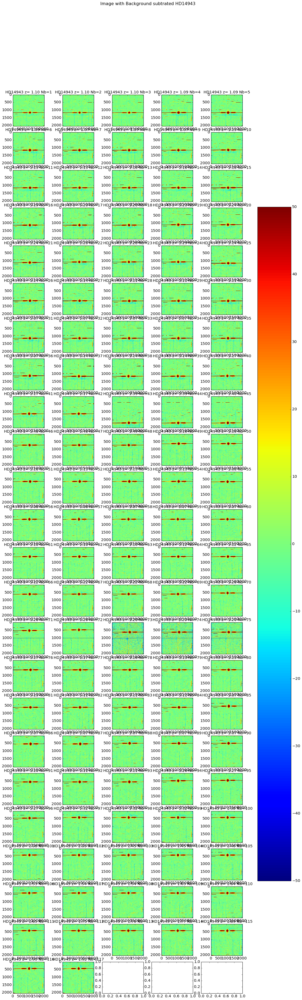

In [45]:
PlotImagesWithBGSubtraction()

In [46]:
def PlotImagesWithBGSubtraction():
    """
    """
    
    global all_ccd_bgsub
    global all_title
    global object_name
    
    NBIMG=len(all_ccd_bgsub)
    MAXIMGROW=int(NBIMG/5)+1
    
    f, axarr = plt.subplots(MAXIMGROW,5,figsize=(20,100))
    for index in np.arange(0,NBIMG):
        ix=index%5
        iy=index/5
        image_flat=all_ccd_bgsub[index].flatten()
        stat_mean=image_flat.mean()
        stat_rms=image_flat.std()
        legtitle='mean={:4.2f} std={:4.2f}'.format(stat_mean,stat_rms)
        axarr[iy,ix].hist(image_flat,bins=120,range=(-50,200),facecolor='blue', alpha=0.75,label=legtitle);
        axarr[iy,ix].set_yscale('log')
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,1e10)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].legend(loc='best')  #useless
    title='histo images bg subtraction {}'.format(object_name)
    plt.suptitle(title,size=16)        

## Save the files with background subtraction
----------------------------------------------------------

In [51]:
sorted_newfiles=[]
for idx,file in np.ndenumerate(sorted_files):
    newfilename='imgbkgsub_'+object_name+'_'+dirlist_all[idx[0]]+'_'+str(sorted_numbers[idx[0]])+'.fits'
    newfullfilename=os.path.join(outputdir,newfilename)
    sorted_newfiles.append(newfullfilename)

In [52]:
for idx,file in np.ndenumerate(sorted_newfiles):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=all_ccd_bgsub[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,clobber=True)

In [53]:

!ls

MakeLogBook.ipynb              logbk_HD14943_ctioNov2016.fits
README.md                      logbk_mucol_ctioNov2016.fits
ViewAllImages_HD14943.ipynb    processed_fitsimages
ViewAllImages_HD1494_v0.ipynb
